In [1]:
from brian2 import *
# if want to avoid explicitly calling show()
%matplotlib inline  

import numpy as np
import matplotlib.pyplot as plt
import pickle, math
from IPython.display import display, Markdown, Latex
from sklearn.model_selection import train_test_split
from os.path import exists
import shapely
from shapely.geometry import LineString, Point, Polygon

<p>[ [ 1, 0, 0, 0 ] , [ 1, 0, 0, 0 ], [ 1, 0, 0, 0 ] , [ 0, 0, 0, 0 ] ]</p>

<div style="float:left; padding-top:60px"></div>
<div style="float:left; padding:10px">
<table>
    <tr><th>A</th><th>B</th><th>C</th><th>D</th></tr>
    <tr><td>1</td><td>0</td><td>0</td><td>0</td></tr> 
    <tr><td>1</td><td>0</td><td>0</td><td>0</td></tr> 
    <tr><td>1</td><td>0</td><td>0</td><td>0</td></tr> 
    <tr><td>0</td><td>0</td><td>0</td><td>0</td></tr> 
    <tr><td colspan="4"><p style="font-size: 60px">&rarr;</p></td></tr>
</table>
</div>
<div style="float:left; padding:10px">-></div>
<div style="float:left; padding:10px">
<table>
    <tr><th>A</th><th>B</th><th>C</th><th>D</th></tr>
    <tr><td>(0, 0)</td><td>(0, 1)</td><td>(0, 2)</td><td>(0, 3)</td></tr> 
    <tr><td>(1, 0)</td><td>(1, 1)</td><td>(1, 2)</td><td>(1, 3)</td></tr> 
    <tr><td>(2, 0)</td><td>(2, 1)</td><td>(2, 2)</td><td>(2, 3)</td></tr> 
    <tr><td>(3, 0)</td><td>(3, 1)</td><td>(3, 2)</td><td>(3, 3)</td></tr> 
    <tr><td colspan="4"><p style="font-size: 60px">&rarr;</p></td></tr>
</table>
</div>

In [2]:
# whole grid
WIDTH = 8 # 16 # 12
HEIGHT = 8 # 20 # 6
X = 8 # 8, 16
Y = 8 # 8 ,16

n_labels = 8
center_percentage = 1-(WIDTH-X)/WIDTH #0.2 # percentage of the space to center
inner_space_percentage = 0.0 # internal percentage of the block

neuron_freq = 1 # the frequency rate of each position
repetitions = 1
time_step = 1 # was 1
time_delay = 10

x_initial = [i+((WIDTH-X)/2)+0.5 for i in range(X)]
#x_exit = [i+((WIDTH-X)/2)+0.5 for i in range(X)]
x_exit = [i+((WIDTH-X)/2)+0.5 for i in range(X)]
y_initial = 0.5
y_exit = Y-0.5

spike_step = 1/neuron_freq

def getLinearFuntionOld(x1, x2, y1, y2):
    if (x2-x1)==0:
        def eq(x):
            return x
    else:
        m = float(y2 - y1)/(x2-x1)
        q = y1 - (m*x1)
        def eq(x):
            return m*x + q
    return eq

# y_initial and y_exit are about the sub matrix
def getLinearFuntion(x1, x2, y_initial, y_exit):
    if (x2-x1)==0:
        def eq(y):
            return x1
    else:
        m = float(y_exit - y_initial)/(x2-x1)
        def eq(x):
            return m*(x-x1) + y_initial
    return eq


def getTrajectoryEquation(x1, x2, y1, y2):
    if (x2-x1)==0:
        def eq(y):
            return x1
    elif (y2-y1)==0:
        def eq(y):
            return y1
    else:
        def eq(y):
            m = float(y2-y1)/(x2-x1)
            return ((y-y1)/m) + x1
            #return m*(y-y1) + y_initial

    return eq


def create_grid(X, Y):
    grid = [[[] for _ in range(X)] for _ in range(Y)]
    for x in range(X):
        for y in range(Y):
            grid[y][x].append(Polygon([(x,y),(x+1,y),(x+1, y+1),(x, y+1)]))
    return grid



def plot_labels(line_color='red', centroid_color='green'):
    position=0
    for label in label_ploygons:
        position+=1
        lines, centroid = label
        plt.plot(*lines.exterior.xy, '-', color=line_color)
        plt.plot(*centroid, '.', color=centroid_color)
        plt.text(centroid[0]-0.2,centroid[1]+1.3, str(position), color='blue')
        
def plot_labels_axes(line_color='red', centroid_color='green', ax=plt):
    position=0
    for label in label_ploygons:
        position+=1
        lines, centroid = label
        ax.plot(*lines.exterior.xy, '-', color=line_color)
        ax.plot(*centroid, '.', color=centroid_color)
        ax.text(centroid[0]-0.2,centroid[1]+1.3, str(position), color='blue')
        
        
        


def compute_positions(traj, WIDTH, HEIGHT):
    boxes = [[[] for _ in range(WIDTH)] for _ in range(HEIGHT)]
    # positive from left to right means choose left, else opposite
    positive = True if (traj.coords.xy[0][1]-traj.coords.xy[0][0]) > 0 else False
    positions = []

    for j in range(len(grid)):
        max_y = 0
        for k in range(len(grid[0])):
            int_pt = traj.intersection(grid[j][k][0])
            coords = int_pt.coords.xy[1]

            if len(int_pt.coords.xy[1]) >= 2:
                delta_y = round(max(int_pt.coords.xy[1])-min(int_pt.coords.xy[1]),2)

                #print(delta_y)
                
                if delta_y > max_y:
                    max_y = delta_y
                elif delta_y == max_y:
                    if positive:
                        delta_y=0.0
                    else:
                        delta_y=1.0

                boxes[j][k].append(delta_y)
            else:
                boxes[j][k].append(0.0)

    for h in range(len(boxes)):
        positions.append(boxes[h].index(max(boxes[h])))
    return positions


def compute_label(traj):
    boxes = [[] for _ in range(len(label_ploygons))]
    # positive from left to right means choose left, else opposite
    positive = True if (traj.coords.xy[0][1]-traj.coords.xy[0][0]) > 0 else False #down direction not treated

    for j in range(len(label_ploygons)):
        max_y = 0
        int_pt = traj.intersection(label_ploygons[j][0])
        coords = int_pt.coords.xy[1]

        
        if len(int_pt.coords.xy[1]) >= 2:
            delta_y = max(int_pt.coords.xy[1])-min(int_pt.coords.xy[1]) # covered height of the block
            
            #if j is one of the two bounds (left or right)
            if (j in [0, len(label_ploygons)-1]) and (delta_y<1.0): # problem here
                if ((traj.coords.xy[0][1] < label_ploygons[j][0].bounds[0]) or ((traj.coords.xy[0][1] > label_ploygons[j][0].bounds[2]))):
                    delta_y = 0.0

            elif delta_y > max_y:
                max_y = delta_y
            elif delta_y == max_y:
                if positive:
                    delta_y=0.0
                else:
                    delta_y=1.0

            boxes[j].append(delta_y)
        elif (len(int_pt.coords.xy[1]) == 1) and (j in [0, len(label_ploygons)-1]) and (max(int_pt.coords.xy[1])==1.0):
            boxes[j].append(1.0)
        else:
            boxes[j].append(0.0)

        #print(boxes, max(max(boxes)))
        if max(max(boxes)) == 0.0:
            position = None
        else:
            position = boxes.index(max(boxes))

    return position


#test
#compute_label(TSTRG)


In [3]:
[i+((WIDTH-X)/2)+0.5 for i in range(X)]

[0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5]

In [4]:

# Plot one trajectory, e.g. 4x4 matrix to 8x8 overpixelling
# position 0 to 2 (on 0-3 pos) or 0.5 to 2.5
x1 = 1+((WIDTH-X)/2)-0.5 # at the center of the initial position
x2 = 7+((WIDTH-X)/2)-0.5 #2.5 #2.9 # at the center of the final position (out of FOV, in target)
y1 = 0.5
y2 = 7.5
#plot([x1, x2],[y1, y2])

#xlim(-1, WIDTH+1)
#ylim(HEIGHT+1, -1)

# function that represents the trajectory
#eq = getLinearFuntion(x1, x2, y1, y2)
#x = np.linspace(x1, WIDTH-0.5, 2) #+0.5

#eq2 = getTrajectoryEquation(x1, x2, y1, y2)
#x = np.linspace(x1-0.5, N, 2) #+0.5

#x_out = (WIDTH-1)/(float(y_exit - y_initial)/(x2-x1))+x1
#print(x_out)
#plot([eq2(0), eq2(11)], [0,11])

# Internal FOV
fov = Polygon([(((WIDTH-X)/2),0.0), (WIDTH-((WIDTH-X)/2),0.0),(WIDTH-((WIDTH-X)/2),Y),(((WIDTH-X)/2),Y)])
#plt.plot(*fov.exterior.xy, '-', color='blue')

# Create Grid
grid = create_grid(WIDTH,HEIGHT)


'''
print(x_out, eq2(10.0))

# Plot grid
for j in range(len(grid)):
    for k in range(len(grid[0])):
        plt.plot(*grid[j][k][0].exterior.xy, ':', color='black')
'''

# Plot labels grid
# The block height is the same, the center is the new point for the equation and can be shifted
border_percentage = (1.0 - center_percentage)/2 # percentage of left and right border
center_space = WIDTH * center_percentage
border_space = WIDTH * border_percentage
#print(center_percentage, border_percentage, center_space, border_space)

label_width = center_space/n_labels
label_ploygons = []
x_left = border_space
inner_space = label_width*inner_space_percentage
label_width = label_width - (2*inner_space)


for _ in range(n_labels):
    lbl = Polygon([(x_left+inner_space, HEIGHT-1),(x_left+label_width+inner_space,HEIGHT-1),(x_left+label_width+inner_space,HEIGHT),(x_left+inner_space, HEIGHT)])
    centroid = (x_left+(label_width/2)+inner_space,HEIGHT-0.5)
    label_ploygons.append((lbl,centroid))
    x_left += label_width+(2*inner_space)
    
    
#plot_labels()


In [5]:
TSTRG = None

In [6]:
# Compute trajectories

combinations = [[[] for _ in range(X)] for _ in range(Y)]
new_trajectories = []
shift = int((WIDTH-X)/2)
for xi in x_initial:
    for target in x_exit:
        #eq
        eq = getTrajectoryEquation(xi, target, y_initial, y_exit)
        #print(x1, y_initial, target, y_exit)
        traj = LineString([(eq(0.0), 0.0), (eq(HEIGHT),HEIGHT)])
        TSTRG = traj
        l = compute_label(traj)

        # Condition to exclude not-in-target trajectories
        #if l == None:
        #    continue
            
            
        # positions (add the rate to compute multiple spikes)
        c_pos = (compute_positions(traj, WIDTH, HEIGHT),[i for i in range(HEIGHT)])
        
        cutted_positions = [v for v in c_pos[0][:X]]
        neurons_idx = []
        for idx in range(len(cutted_positions)):
            neurons_idx.append((len(cutted_positions)*idx)+cutted_positions[idx]-shift)
        
        if eq(HEIGHT)>=0 and eq(HEIGHT)<=WIDTH:
            new_trajectories.append((neurons_idx,
                                    cutted_positions[0], # initial position
                                    cutted_positions[-1], # final position (Label)
                                    (cutted_positions,c_pos[1][:X]), # real spikes for neurons
                                    (traj.coords.xy[0],traj.coords.xy[1]),
                                    l,
                                    (c_pos[0],c_pos[1])))

# extract FOV x
# add start and end for lines plotting x
# add neurons id

if len(new_trajectories) != (X*Y):
    raise("NOT All the combinations have been generated!! Please increase the FOV WIDTH.")

In [7]:
# Test trajectories - 64
shift_to_0 = int(x_initial[0]-0.5)
tm = 0
for trj in new_trajectories:
    print(trj[1]-shift_to_0, trj[2]-shift_to_0+X, trj[5], tm)
    tm+=(Y-1)

0 8 0 0
0 9 1 7
0 10 2 14
0 11 3 21
0 12 4 28
0 13 5 35
0 14 6 42
0 15 7 49
1 8 0 56
1 9 1 63
1 10 2 70
1 11 3 77
1 12 4 84
1 13 5 91
1 14 6 98
1 15 7 105
2 8 0 112
2 9 1 119
2 10 2 126
2 11 3 133
2 12 4 140
2 13 5 147
2 14 6 154
2 15 7 161
3 8 0 168
3 9 1 175
3 10 2 182
3 11 3 189
3 12 4 196
3 13 5 203
3 14 6 210
3 15 7 217
4 8 0 224
4 9 1 231
4 10 2 238
4 11 3 245
4 12 4 252
4 13 5 259
4 14 6 266
4 15 7 273
5 8 0 280
5 9 1 287
5 10 2 294
5 11 3 301
5 12 4 308
5 13 5 315
5 14 6 322
5 15 7 329
6 8 0 336
6 9 1 343
6 10 2 350
6 11 3 357
6 12 4 364
6 13 5 371
6 14 6 378
6 15 7 385
7 8 0 392
7 9 1 399
7 10 2 406
7 11 3 413
7 12 4 420
7 13 5 427
7 14 6 434
7 15 7 441


In [8]:
new_trajectories

[([0, 8, 16, 24, 32, 40, 48, 56],
  0,
  0,
  ([0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 2, 3, 4, 5, 6, 7]),
  (array('d', [0.5, 0.5]), array('d', [0.0, 8.0])),
  0,
  ([0, 0, 0, 0, 0, 0, 0, 0], [0, 1, 2, 3, 4, 5, 6, 7])),
 ([0, 8, 16, 24, 33, 41, 49, 57],
  0,
  1,
  ([0, 0, 0, 0, 1, 1, 1, 1], [0, 1, 2, 3, 4, 5, 6, 7]),
  (array('d', [0.4285714285714286, 1.5714285714285714]),
   array('d', [0.0, 8.0])),
  1,
  ([0, 0, 0, 0, 1, 1, 1, 1], [0, 1, 2, 3, 4, 5, 6, 7])),
 ([0, 8, 17, 25, 33, 41, 50, 58],
  0,
  2,
  ([0, 0, 1, 1, 1, 1, 2, 2], [0, 1, 2, 3, 4, 5, 6, 7]),
  (array('d', [0.35714285714285715, 2.642857142857143]),
   array('d', [0.0, 8.0])),
  2,
  ([0, 0, 1, 1, 1, 1, 2, 2], [0, 1, 2, 3, 4, 5, 6, 7])),
 ([0, 8, 17, 25, 34, 42, 51, 59],
  0,
  3,
  ([0, 0, 1, 1, 2, 2, 3, 3], [0, 1, 2, 3, 4, 5, 6, 7]),
  (array('d', [0.2857142857142857, 3.714285714285714]),
   array('d', [0.0, 8.0])),
  3,
  ([0, 0, 1, 1, 2, 2, 3, 3], [0, 1, 2, 3, 4, 5, 6, 7])),
 ([0, 9, 17, 26, 34, 43, 51, 60],
  0,
  4,
  

In [9]:
plt.rcParams['figure.dpi'] = 72.0

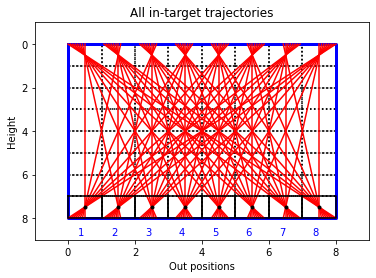

In [10]:
# Plot grid
figure()
plt.xlim(-1, WIDTH+1)
plt.ylim(HEIGHT+1, -1)
for j in range(len(grid)):
    for k in range(len(grid[0])):
        plt.plot(*grid[j][k][0].exterior.xy, ':', color='black')
        
        
# Plot FOV
plt.plot(*fov.exterior.xy, '-', color='blue', linewidth=3)


# Plot all trajectories
for a, b, c, d, e, f, g in new_trajectories:
    plot(e[0],e[1], '-',color='red')
plt.title('All in-target trajectories')
plt.xlabel('Out positions')
plt.ylabel('Height')

plot_labels('black','black')

<BarContainer object of 8 artists>

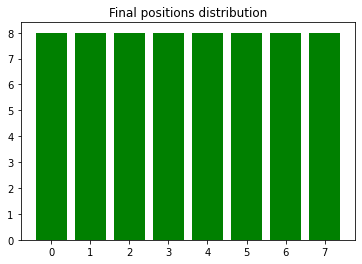

In [11]:
# print covered outs
outs = dict()
o = [i[5] for i in new_trajectories if i[5] is not None]
min_out = min(o)
max_out = max(o)
for i in range(max_out+1):
    outs[i] = 0

for out in o:
    outs[out] += 1

plt.title('Final positions distribution')
plt.bar(outs.keys(), outs.values(), color='g')

In [12]:
outs_asc = {k: v for k, v in sorted(outs.items(), key=lambda item: item[1])}

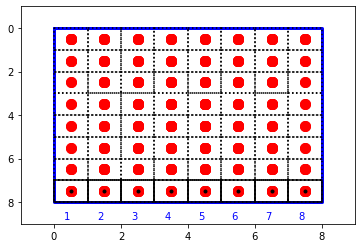

In [13]:
def plot_grid():
    plt.xlim(-1, WIDTH+1)
    plt.ylim(HEIGHT+1, -1)

    # Plot FOV
    plt.plot(*fov.exterior.xy, '-', color='blue', linewidth=3)

    for j in range(len(grid)):
        for k in range(len(grid[0])):
            # covered
            plt.plot(*grid[j][k][0].exterior.xy, ':', color='black')
            
def plot_grid_axes(ax=plt):
    ax.set_xlim(-1, WIDTH+1)
    ax.set_ylim(HEIGHT+1, -1)

    # Plot FOV
    ax.plot(*fov.exterior.xy, '-', color='blue', linewidth=3)

    for j in range(len(grid)):
        for k in range(len(grid[0])):
            # covered
            ax.plot(*grid[j][k][0].exterior.xy, ':', color='black')


# Plot grid
figure()
plt.xlim(-1, WIDTH+1)
plt.ylim(HEIGHT+1, -1)

# Plot FOV
plt.plot(*fov.exterior.xy, '-', color='blue', linewidth=3)

for j in range(len(grid)):
    for k in range(len(grid[0])):
        plt.plot(*grid[j][k][0].exterior.xy, ':', color='black')

for h in new_trajectories:
    x,y=h[4]
    #plt.plot(np.array(x),np.array(y),'-')
    x,y=h[6]
    plt.plot(np.array(x)+0.5,np.array(y)+0.5,'.',markersize=20, color='red')
    #plt.xlim(-1, WIDTH+1)
    #plt.ylim(HEIGHT+1, -1)

        
unique_trajectories = new_trajectories
neurons = WIDTH
N=X**2
Nruns = repetitions

#time_step = 0.01 # was 1
#time_delay = 10

exclude_rows = []#[6,7]
exclude_neurons = []


for r in exclude_rows:
    for i in range(neurons):
        exclude_neurons.append(r * neurons + i)
        

plot_labels('black','black')

In [14]:
# convert into times and indexes
def time_converter(trajectories, time_delay=1, sample_delay=10, num_spikes=1, repetitions=1):
    input_indexes = []
    input_times = []
    
    label_indexes = []
    label_times = []
    
    clock = 0
    
    for _ in range(repetitions):
        for sample, start, end, _, a, label, b in trajectories:
                if label is not None:
                    for t in sample:
                        input_indexes.append(t)
                        input_times.append(clock*msecond)
                        clock += (time_delay)

                    label_indexes.append(label)
                    label_times.append(clock*msecond)
                    clock += (sample_delay)
                
    return input_indexes, input_times, label_indexes, label_times, clock

In [15]:
# split train set and test set - should be selected using 6-2 for each starting point
# e.g. start from 1 to 4 and 1 to 8 for test, others for train, randomly selected

# group variable
#trajectories_group = [[] for _ in range(X)]
trajectories_group_initial = [[] for _ in range(X)]
trajectories_group_labels = [[] for _ in range(len(label_ploygons))]

# read uniques trajectories and group by last ROW neuron index - for uniform distribution
for elem in unique_trajectories:
    tmp_traj, start_idx, end_idx, a, b, label, d = elem
    trajectories_group_initial[start_idx-shift].append(elem)
    if label is not None:
        trajectories_group_labels[label].append(elem)
        #trajectories_group[start_idx-shift].append(elem)

# trajectories_group_initial is sorted by initial position (all the trajectories from a starting point)
# trajectories_group_labels is sorted by labels (all the trajectories ending with a label)

trajectories_group=trajectories_group_initial
#trajectories_group=trajectories_group_labels

# select 25% of test and 75% of train for each output neuron and append it into the whole train set and test set
training_data = []
testing_data = []

# should be insert ordering by trajectory group and pick one for each randomly but sequentially from groups 
# to maintain constant the voltage between output neurons and well compare the parameters
for trg in trajectories_group:
    tr_data, ts_data = train_test_split(trg, test_size=0.25) #0.25
    #tr_data = trg # full training
    for e_tr in tr_data:
        training_data.append(e_tr)
    for e_ts in ts_data:
        testing_data.append(e_ts)
        
# remove last 


# check if train file and test file exist
train_filename = "data/8x8_100/train_set_75_100.trj"
test_filename = "data/8x8_100/test_set_25_100.trj"
train_file_exists = exists(train_filename)
test_file_exists = exists(test_filename)
override = True

if train_file_exists and not override:
    print("training set loaded")
    train_file = open(train_filename, 'rb')
else:
    train_file = open(train_filename, 'wb')
    pickle.dump(training_data, train_file)
    print("training set saved")
    
if test_file_exists and not override:
    print("test set loaded")
    test_file = open(test_filename, 'rb')
else:
    test_file = open(test_filename, 'wb')
    pickle.dump(testing_data, test_file)
    print("test set saved")      
        
        
# test set
import random
random.seed(0)

#train_data = random.choices(training_data, k=300)
#test_data = random.choices(testing_data, k=20)
#training_data = list(np.array(training_data)[::-1])


#train_data = [elem for _ in range(repetitions) for elem in training_data]
train_data = training_data
test_data = testing_data

clock = 0
target_delta_ratio = HEIGHT-Y
label_delay = time_step*target_delta_ratio

# -------------------------------------------------------------------------------
# ------------------ New approach with FOV first and last row -------------------
# -------------------------------------------------------------------------------
# - In this method the spikes train is simplified removing all the intermediate - 
# - spikes in the FOV and considering first and last pixel row only -------------
# -------------------------------------------------------------------------------

shift_to_0 = int(x_initial[0]-0.5)
FL_neuron_idx = []
FL_neuron_times = []
FL_label_idx = []
FL_label_times = []

False

#Training and Testing spike time series
train_indexes, train_times, label_indexes, label_times, clock = time_converter(train_data, time_step, time_delay, neuron_freq, repetitions)
t_training = clock*msecond
t_total = clock*msecond

test_indexes, test_times, label_test_indexes, label_test_times, clock = time_converter(test_data, time_step, time_delay, neuron_freq)
t_testing = clock*msecond
t_total += clock*msecond

training set saved
test set saved


In [16]:
t_training

0.864 * second

In [17]:
plt.rcParams['figure.dpi'] = 1200
#plt.rcParams['savefig.dpi'] = 1200
def plot_trajectories(trajectories, elem_for_figure, title="", xlab="", ylab="", fg=None):
    idx = 0
    shift_x = 0.5
    shift_y = 0.5
    if fg is not None:
        subplot(fg)
        #subplot(fg[0],fg[1],fg[2])
    else:
        figure()
    plot_grid()
    for x, y in trajectories:
        if fg is not None and idx >= elem_for_figure:
            figure()
            idx = 0
        plt.plot([i+shift_x for i in x], [i+shift_y for i in y], 'o')
        plt.plot([x[0]+shift_x,x[-1]+shift_x], [y[0]+shift_y, y[-1]+shift_y], '-')
        
        plt.xlim(-1,WIDTH+1)
        plt.ylim(HEIGHT+1,-1)
        
        plt.title(title)
        plt.xlabel(xlab)
        plt.ylabel(ylab)
        plt.axis('scaled')
        xticks(range(0, WIDTH+1))
        yticks(range(0, HEIGHT+1))
        idx += 1
        
        
def plot_trajectories_axes(trajectories, title="", xlab="", ylab="", ax=plt):
    idx = 0
    shift_x = 0.5
    shift_y = 0.5
    plot_grid_axes(ax)
    for x, y in trajectories:
        ax.plot([i+shift_x for i in x], [i+shift_y for i in y], 'o')
        ax.plot([x[0]+shift_x,x[-1]+shift_x], [y[0]+shift_y, y[-1]+shift_y], '-')
        
        ax.set_xlim(-1,WIDTH+1)
        ax.set_ylim(HEIGHT+1,-1)
        
        ax.set_title(title)
        ax.set_xlabel(xlab)
        ax.set_ylabel(ylab)
        ax.axis('scaled')
        ax.set_xticks(range(0, WIDTH+1))
        ax.set_yticks(range(0, HEIGHT+1))
        idx += 1


plots = [x[6] for x in train_data]

fig, axs = plt.subplots(2, 2, figsize=(12,10))

plot_trajectories_axes(plots, title='All trajectories',xlab='Position index', ax=axs[0, 0])
plot_labels_axes('black','black',ax=axs[0, 0])

axs[0,1].plot(train_times/ms, train_indexes, 'o')
#axs[0,1].plot(test_times/ms, test_indexes, 'o')
axs[0,1].axvline(label_times[-1]/ms, color='b', linestyle='dashed') # vertical

#plot_trajectories(plots, neurons)
#plot_trajectories(plots, 1)
plot_trajectories_axes([train_data[i][3] for i in range(len(train_data))], title='Training trajectories',xlab='Position index', ax=axs[1, 0])
plot_labels_axes('black','black',ax=axs[1, 0])


plot_trajectories_axes([test_data[i][3] for i in range(len(test_data))], title='Testing trajectories',xlab='Position index', ax=axs[1, 1])
plot_labels_axes('black','black',ax=axs[1, 1])

plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.1, 
                    hspace=0.4)

#plot_trajectories(plots, 1, title='All trajectories',xlab='Position index')




def plot_groups(groups, subtitle=""):
    out_idx = 0
    fg_idx=1
    fg_el_per_row=4
    fg_row=1
    figure(figsize=(20,4))
    for group in groups:
        out_idx += 1

        gr = [x[6] for x in group]
        if fg_idx>4:
            fg_row+=1
            fg_idx=1
            figure(figsize=(20,4))

        fg_config = '1'+str(fg_el_per_row)+str(fg_idx)
        #fg_config = (3,4,out_idx)
        fg_idx+=1

        plot_trajectories(gr, len(gr), title='Trajectories for '+subtitle+' '+str(out_idx),xlab='Position index',fg=fg_config)
        plot_labels('black','black')
        
    # fill empty subplots
    for h in range(fg_el_per_row-fg_idx+1):
        fg_config = '1'+str(fg_el_per_row)+str(fg_idx)
        subplot(fg_config)
        axis('off')
        fg_idx+=1

plot_groups(trajectories_group_initial, 'input')
#plot_labels('black','black')
plot_groups(trajectories_group_labels, 'output')
#plot_labels('black','black')


        

WARNING    /var/folders/6m/jw_42_bs0p75rv0sycqq52pr0000gn/T/ipykernel_89885/932340386.py:8: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  subplot(fg)
 [py.warnings]


<h3>Neuron Model: leaky integrate-and-fire (LIF)</h3>
<p>Neocortical neurons are rather leaky integrators, and they use conductance-based synapses which means the change of the membrane voltage due to a spike depends on the current membrane voltage.</p>

<p>The membrane voltage $V$ is described by:

$$
\tau d V = (E_{rest}-V)+g_{e}(E_{exc}-V)+g_{i}(E_{inh}-V)
$$

where $E_{rest}$ is the resting membrane potential, $E_{exc}$ and $E_{inh}$ are the equilibrium potentials of excitatory and inhibitory synapses, and $g_{e}$ and $g_{i}$ are the conductances <sup><a href="#conductance">3</a></sup> of excitatory and inhibitory synapses. As observed in biology, we use a time constant $\tau$, which is longer for excitatory neurons than for inhibitory neurons. When the neuron’s membrane potential crosses its membrane threshold $V_{threshold}$, the neuron fires and its membrane potential is reset to $V_{reset}$. Within the next few milliseconds after the reset, the neuron is in its refractory period and cannot spike again.
    
Synapses are modeled by conductance changes: a synapse increases its conductance when a presynaptic action potential arrives at the synapse by its synaptic weight $w$. Otherwise, the conductance is decaying exponentially. The dynamics of the synaptic conductance are given by:
    
$$\tau_{g_{e}}\frac{dg_{e}}{dt}=-g_{e},\quad \tau_{g_{i}}\frac{dg_{i}}{dt}=-g_{i}.$$
</p>


<h3>Learning Rule: Spike-timing-dependent plasticity (STDP)</h3>

<p>
STDP is used to modify the weights of synapses connecting certain neuron groups. We call the neuron from which a synapse projects <i>presynaptic</i>, and the one to which it connects <i>postsynaptic</i>. For the sake of computational efficiency, we use online STDP, where values $a_{pre}$ and $a_{post}$ (synaptic traces) are recorded for each synapse, a simple decaying memory of recent spiking history. Each time a <i>presynaptic</i> (<i>postsynaptic</i>) spike occurs at the synapse, $a_{pre}$ ($a_{post}$) is set to 1; otherwise, it decays exponentially to zero with a time course chosen in a biologically plausible range. When a spike arrives at the synapse, the weight change $\Delta w$ is calculated using a STDP learning rule. 
    
The rule we use in our simulations is given by:
    
$$\Delta w = \begin{cases}\eta_{post}a_{pre}(w_{max}-w) \qquad\;\!\textrm{on postsynaptic spike}\\ -\eta_{pre}a_{post}w \quad\qquad\qquad\textrm{on presynaptic spike}\end{cases} $$
    
where terms $\eta_{post}$, $\eta_{pre}$ denote learning rates, and $w_{max}$ is the maximum allowed synaptic weight.
    
</p>


<p>[1] <a href="https://doi.org/10.3389/fncom.2015.00099">Unsupervised learning of digit recognition using spike-timing-dependent plasticity</a>
</p>
<p>[2] <a href="https://doi.org/10.48550/arXiv.1808.08173">STDP Learning of Image Patches with Convolutional Spiking Neural Networks</a></p>
<p id="conductance">[3] </p>

In [18]:
# ---------------------------------------------
# ---------------- PARAMETERS -----------------
# ---------------------------------------------

#neuron
taum = 2*ms # 2*ms decay rate for neuron

Eexc = 0*mV
Erest = -60*mV #ex -60

taue = 1*ms # exitatory time constant
ge = 0.1 # conductance exitatory

tauL = 1*ms # exitatory time constant
gL = 0 # conductance exitatory from Labels

vthreshold = -48*mV #vt -54 for testing
vreset = -60*mV #vr

#synapses
tauW = 15000*ms # 50*ms decay rate for synapses

taupre = 3*ms
#taupost = ((time_step*Y)+time_delay+label_delay)*ms
#taupost = (time_step*Y)*ms
taupost = 10.8*ms

#wL = 1.
gmax = 0.5 # 0.02
dApre = 0.125
dApost = -0.025


refractory = 5*ms
weights = 'rand() * gmax/10' #/10


# LIF
# (unless refractory)
eqs_neurons = '''
dv/dt = ((Erest - v) + (ge * (Eexc-v)) + (gL * (Eexc-v))) / taum : volt (unless refractory)
dge/dt = -ge / taue : 1
dgL/dt = -gL / tauL : 1
'''

# STDP

eqs_out = '''
dw/dt = -w/tauW : 1
dApre/dt = -Apre / taupre : 1 (event-driven)
dApost/dt = -Apost / taupost : 1 (event-driven)
'''

eqs_out_pre = '''
ge += w
Apre += dApre
w = clip(w + Apost, 0, gmax)
'''
# Apre += dApre

eqs_out_post = '''
Apost += dApost
w = clip(w + Apre, 0, gmax)
'''
# Apost += dApost
# clip set values less than minimum to 0 and values greater than maximum to gmax, or leave it in the middle



In [19]:

from utils.Parameters import Parameters
from utils.Configurations import Configurations
parameters = Parameters(taum, Eexc, Erest, taue, ge, tauL, gL, vthreshold, vreset, tauW, taupre, taupost, gmax, dApre, dApost, refractory)

conf = Configurations('data/configurations_2023.cnf')
conf.add(parameters)

# if exists what is the configuration?
# improve the configuration class saving also the model


Parameters for this configuration already exist


In [20]:

params_list = conf.get()
display(Markdown('<h3>All parameters</h3>'))

tbl = "<table><tr><th>ID</th>" + params_list[0].print_tbl_header() + "</tr>"
cnt_id = 0
for prms in params_list:
    tbl += "<tr><td>" + str(cnt_id) + "</td>" +prms.print_tbl_row() + "</tr>"
    cnt_id += 1

display(Markdown(tbl+"</table>"))


<h3>All parameters</h3>

<table><tr><th>ID</th><th>taum</th><th>Eexc</th><th>Erest</th><th>taue</th><th>ge</th><th>tauL</th><th>gL</th><th>vthreshold</th><th>vreset</th><th>tauW</th><th>taupre</th><th>taupost</th><th>gmax</th><th>dApre</th><th>dApost</th><th>refractory</th></tr><tr><td>0</td><td>2. ms</td><td>0. V</td><td>-60. mV</td><td>1. ms</td><td>0.1</td><td>1. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>50. ms</td><td>2. ms</td><td>4. ms</td><td>0.5</td><td>0.2</td><td>-0.11000000000000001</td><td>5. ms</td></tr><tr><td>1</td><td>2. ms</td><td>0. V</td><td>-60. mV</td><td>1. ms</td><td>0.1</td><td>1. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>2. ms</td><td>4. ms</td><td>0.5</td><td>0.2</td><td>-0.11000000000000001</td><td>5. ms</td></tr><tr><td>2</td><td>2. ms</td><td>0. V</td><td>-60. mV</td><td>1. ms</td><td>0.1</td><td>1. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>2. ms</td><td>14. ms</td><td>0.5</td><td>0.2</td><td>-0.03142857142857143</td><td>5. ms</td></tr><tr><td>3</td><td>2. ms</td><td>0. V</td><td>-60. mV</td><td>3. ms</td><td>0.1</td><td>3. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>2. ms</td><td>14. ms</td><td>0.5</td><td>0.2</td><td>-0.03142857142857143</td><td>5. ms</td></tr><tr><td>4</td><td>5. ms</td><td>0. V</td><td>-60. mV</td><td>5. ms</td><td>0.1</td><td>3. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>2. ms</td><td>14. ms</td><td>0.5</td><td>0.2</td><td>-0.03142857142857143</td><td>5. ms</td></tr><tr><td>5</td><td>10. ms</td><td>0. V</td><td>-60. mV</td><td>10. ms</td><td>0.1</td><td>3. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>5. ms</td><td>14. ms</td><td>0.5</td><td>0.2</td><td>-0.07857142857142857</td><td>5. ms</td></tr><tr><td>6</td><td>2. ms</td><td>0. V</td><td>-60. mV</td><td>2. ms</td><td>0.1</td><td>3. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>2. ms</td><td>4. ms</td><td>0.5</td><td>0.2</td><td>-0.11000000000000001</td><td>4. ms</td></tr><tr><td>7</td><td>1. ms</td><td>0. V</td><td>-60. mV</td><td>2. ms</td><td>0.1</td><td>3. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>2. ms</td><td>4. ms</td><td>0.02</td><td>0.008</td><td>-0.0044</td><td>4. ms</td></tr><tr><td>8</td><td>1. ms</td><td>0. V</td><td>-60. mV</td><td>2. ms</td><td>0.1</td><td>3. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>20. ms</td><td>4. ms</td><td>0.02</td><td>0.008</td><td>-0.044000000000000004</td><td>4. ms</td></tr><tr><td>9</td><td>1. ms</td><td>0. V</td><td>-60. mV</td><td>20. ms</td><td>0.1</td><td>11. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>200. ms</td><td>2. ms</td><td>4. ms</td><td>0.02</td><td>0.008</td><td>-0.0044</td><td>4. ms</td></tr><tr><td>10</td><td>2. ms</td><td>0. V</td><td>-60. mV</td><td>1. ms</td><td>0.1</td><td>1. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>1.5 s</td><td>3. ms</td><td>15. ms</td><td>0.5</td><td>0.125</td><td>-0.036</td><td>5. ms</td></tr><tr><td>11</td><td>2. ms</td><td>0. V</td><td>-60. mV</td><td>1. ms</td><td>0.1</td><td>1. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>1.5 s</td><td>3. ms</td><td>10.8 ms</td><td>0.5</td><td>0.125</td><td>-0.025</td><td>5. ms</td></tr><tr><td>12</td><td>2. ms</td><td>0. V</td><td>-60. mV</td><td>1. ms</td><td>0.1</td><td>1. ms</td><td>0</td><td>-48. mV</td><td>-60. mV</td><td>15. s</td><td>3. ms</td><td>10.8 ms</td><td>0.5</td><td>0.125</td><td>-0.025</td><td>5. ms</td></tr></table>

### Load configuration overwriting variables



In [21]:
CONFIGURATION = -1 # 44 when the delay between inputs is 20ms
PARAMS = params_list[CONFIGURATION] # best 32 -1 is last # not bad 47
taum = PARAMS.taum
Eexc = PARAMS.Eexc
Erest = PARAMS.Erest
taue = PARAMS.taue
ge = PARAMS.ge
tauL = PARAMS.tauL
gL = PARAMS.gL
vthreshold = PARAMS.vthreshold
vreset = PARAMS.vreset
tauW = PARAMS.tauW
taupre = PARAMS.taupre
taupost = PARAMS.taupost
gmax = PARAMS.gmax
dApre = PARAMS.dApre
dApost = PARAMS.dApost
refractory = PARAMS.refractory
weights = 'rand() * gmax/10' #2

### Simulation description



In [22]:
# ---------------------------------------------
# ---------------- SIMULATION -----------------
# ---------------------------------------------

pretrained = True

start_scope()

#input = PoissonGroup(N, rates=F)
#print(train_plot)
#print(time_plot)
#print(ind_Label)
#print(lab)
#print(t_total)


#G = SpikeGeneratorGroup(N, ind_Train, train)
#G = SpikeGeneratorGroup(N, train_plot, time_plot)
#G = SpikeGeneratorGroup(N, tr_p, tm_p)
#Label = SpikeGeneratorGroup(neurons, ind_Label, lab)
neurons = n_labels
G = SpikeGeneratorGroup(N, train_indexes, train_times)
Label = SpikeGeneratorGroup(neurons, label_indexes, label_times)

out = NeuronGroup(neurons, eqs_neurons, threshold='v>vthreshold', reset='v = vreset', refractory=refractory,
                      method='euler')

S = Synapses(G, out, eqs_out,
             on_pre=eqs_out_pre,
             on_post=eqs_out_post,
             )
S.connect()


Syn_L = Synapses(Label, out, on_pre='''gL += 1''') # ex 1
#Syn_L = Synapses(Label, out)
Syn_L.connect(j='i') 


if pretrained:
    # load pretrained weights 100 accuracy
    import json
    with open('data/8x8_100/100_weights.json') as f:
        lw = json.load(f)

    for wi in range(len(lw)):
        S.w[wi] = lw[wi]
else:
    S.w = weights
    #S.w = 'gmax/10'


# INHIBITORY
#Syn_inh = Synapses(Label, out, on_pre='''gL *= 0.1''')
#Syn_inh = Synapses(out, out, on_pre='''ge *= 0.1''') #0.2

#Syn_inh = Synapses(out, out, on_pre='''ge *= -0.1''') #0.2
#Syn_inh = Synapses(out, out, on_pre='''gL = -ge''') #0.2

#Syn_inh = Synapses(out, out, on_post='''gL += 1''') #0.2
#for ilab in range(n_labels):
#    for nj in range(n_labels):
#        if ilab == nj:
#            continue
#        Syn_inh.connect(i=ilab, j=nj)



out.v = vreset*ones(neurons)

neur = [ii for ii in range(neurons)]

all_ = [ii for ii in range(N*neurons)]
first_and_last = [0, 1, 2, 3, 4, 5, 6, 7, 56, 57, 58, 59, 60, 61, 62, 63]
last = [ii for ii in range((X*(X-1)),(X**2))]


mon = StateMonitor(S, 'w', record=all_)
mon_ge = StateMonitor(out, 'ge', record=neur)
mon_gL = StateMonitor(out, 'gL', record=neur)
mon_v = StateMonitor(out, 'v', record=neur)

#mon_LabelSyn = StateMonitor(Syn_L, 'ge', record=neur)

spike_mon = SpikeMonitor(G)
s_mon_out = SpikeMonitor(out)

#run(0.001*t_total*second)
run(t_training)



INFO       The synaptic equation for the variable w does not specify whether it should be integrated at every timestep ("clock-driven") or only at spiking events ("event-driven"). It will be integrated at every timestep which can slow down your simulation unnecessarily if you only need the values of this variable whenever a spike occurs. Specify the equation as clock-driven explicitly to avoid this warning. [brian2.synapses.synapses.clock_driven]
In file included from /Users/nicolarusso/Library/Caches/cython/brian_extensions/_cython_magic_a22693cd45db69f84a0ab484131ce6da.cpp:30:
/Users/nicolarusso/opt/anaconda3/envs/phd/include/python3.8/Python.h:14:2: error: "Something's broken.  UCHAR_MAX should be defined in limits.h."
#error "Something's broken.  UCHAR_MAX should be defined in limits.h."
 ^
/Users/nicolarusso/opt/anaconda3/envs/phd/include/python3.8/Python.h:18:2: error: "Python's source code assumes C's unsigned char is an 8-bit type."
#error "Python's source code assumes C's unsi

INFO       Cannot use compiled code, falling back to the numpy code generation target. Note that this will likely be slower than using compiled code. Set the code generation to numpy manually to avoid this message:
prefs.codegen.target = "numpy" [brian2.devices.device.codegen_fallback]
WARNING    "i" is an internal variable of group "synapses_1", but also exists in the run namespace with the value 7. The internal variable will be used. [brian2.groups.group.Group.resolve.resolution_conflict]
WARNING    "gL" is an internal variable of group "neurongroup", but also exists in the run namespace with the value 0. The internal variable will be used. [brian2.groups.group.Group.resolve.resolution_conflict]
WARNING    "ge" is an internal variable of group "neurongroup", but also exists in the run namespace with the value 0.1. The internal variable will be used. [brian2.groups.group.Group.resolve.resolution_conflict]
INFO       No numerical integration method specified for group 'synapses', using

WARNING    /var/folders/6m/jw_42_bs0p75rv0sycqq52pr0000gn/T/ipykernel_89885/1829975541.py:76: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  subplot(sub_plt_conf)
 [py.warnings]
WARNING    /var/folders/6m/jw_42_bs0p75rv0sycqq52pr0000gn/T/ipykernel_89885/1829975541.py:76: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  subplot(sub_plt_conf)
 [py.warnings]
WARNING    /var/folders/6m/jw_42_bs0p75rv0sycqq52pr0000gn/T/ipykernel_89885/1829975541.py:76: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  subplot(sub_plt_conf)
 [py.warnings]
WARNING    /var/folders/6m/jw_42_bs0p75rv0sycqq52pr0000gn/T/ipykernel_89885/1829975541.py:76: MatplotlibDeprecationWar

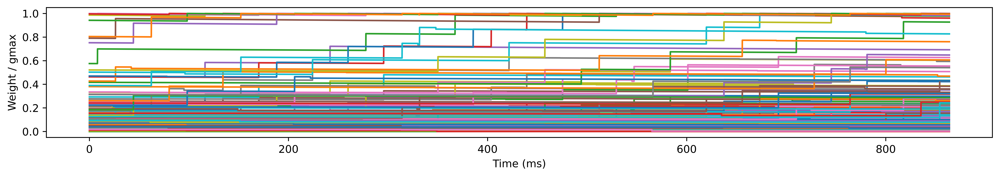

In [23]:
# ---------------------------------------------
# ------------------- PLOTS -------------------
# ---------------------------------------------

#plot params
split_spikes = True
limit = False

x_start = 1800
t_total = t_training
x_end = (t_total/ms)+30

x_start = -5
x_end = 30


figure(figsize=(16,4))
subplot(211)
plot(spike_mon.t/ms, spike_mon.i, '.k')
xlabel('Time (ms)')
ylabel('Neuron index')
#plt.axvline(label_times[-1]/ms, color='b', linestyle='dashed') # vertical
if limit:
    xlim(x_start,x_end)
else:
    xlim(-30, (t_total/ms)) # ex xlim(-30, (t_total/ms)+30)

subplot(212)
plot(label_times/ms, label_indexes, 'o')
#plot(label_test_times/ms, label_test_indexes, 'o')

plot(s_mon_out.t/ms, s_mon_out.i, '.k')
#plot(lab/ms, ind_Label+0.3, 'o')
xlabel('Time (ms)')
ylabel('Neuron index')
#plt.axvline(label_times[-1]/ms, color='b', linestyle='dashed') # vertical
if limit:
    xlim(x_start,x_end)
else:
    xlim(-30, (t_total/ms)) # ex xlim(-30, (t_total/ms)+30)


figure(figsize=(13,4))
subplot(121)
plot(S.w / gmax, '.k')
ylabel('Weight / gmax')
xlabel('Synapse index')
subplot(122)
hist(S.w / gmax, 20)
xlabel('Weight / gmax')
tight_layout()
#show()

figure(figsize=(16,24))
subplot(911)
plot(mon.t/ms, mon.w.T/gmax)
xlabel('Time (ms)')
ylabel('Weight / gmax')



def filter_out_neuron(idx, times, neuron):
    out_indexes = []
    out_timings = []
    
    for i in range(len(idx)):
        if idx[i] == neuron:
            out_indexes.append(idx[i])
            out_timings.append(times[i])
    return out_timings, out_indexes


def plot_output_neuron(idx, sub_plt_conf, COLOR_IDX, COLORS):
    #OUTPUT POS idx
    lx, ly = filter_out_neuron(label_indexes, label_times, idx)
    subplot(sub_plt_conf)
    plot(lx/ms, ly, 'o')
    
    
    if COLOR_IDX == len(COLORS):
        COLOR_IDX = 0
    color = COLORS[COLOR_IDX]
    COLOR_IDX += 1
    
    if split_spikes:
        for lx_ in lx:
            plt.axvline(lx_/ms, color=color[0], linestyle='dashed') # vertical

    ratio = 6 # 6
    plot(mon_ge.t/ms, mon_ge.ge[idx], color[1])
    plot(mon_v.t/ms, ((mon_v.v[idx]+60*mV)/ratio)/mV, color[2])
    plot(s_mon_out.t/ms, s_mon_out.i, '.', color=color[3])
    xlabel('Time (ms)')
    ylabel('Neuron index')
    title('Out Position '+str(idx+1), fontsize=14, fontweight='bold')
    if limit:
        xlim(x_start,x_end)
    
    return COLOR_IDX
        

COLORS = [
        ('b','k','r','k'),
        ('b','k','green','k'),
        ('b','k','c','k'),
        ('b','k','gold','k'),
        ('b','k','royalblue','k'),
        ('b','k','m','k')
         ]
COLOR_IDX = 0


# rows
elem_per_row = 4
module = n_labels%elem_per_row
rows = int(n_labels/elem_per_row)+ (0 if module == 0 else 1)
lab_cnt = 0

for j in range(rows):
    if lab_cnt>n_labels:
        break
        
    figure(figsize=(16,10))
    plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=0.5, wspace=0.4)
    for k in range(elem_per_row):
        if lab_cnt>=n_labels:
            break
        
        COLOR_IDX = plot_output_neuron(lab_cnt, str(elem_per_row)+'1'+str(k+1), COLOR_IDX, COLORS)
        lab_cnt+=1


plt.style.use("default")
#tight_layout()
#show()

### Analysis

<p>
In the previous block it was plotted data about the spiking input [1] with the respectively labels [2] (and spiking results) during training,  the synapses weight distribution [3][4] and [5] for the first and last synapses, and the voltage and capacitance of the twelve output neurons [6-17].
<br>
Input description, timings,...
<br>
Looking at the input, the training is performed correctely, assigning all the labels to the right spike neuron. One of the best configuration was the <b>32<sup>th</sup></b> performed with an 8x8 input matrix and with the labels matching the last row. When the same configuration is runned with different input, in particular when the labels happens at different time and in a different position, the SNN works better with the configuration <b>34</b>, where the taupost is increased from 10.8ms to 15ms.
<br>
One possible improvement can be done when the SNN is trained choosing the same amount of samples for each final position. As a matter of fact, the vertical dashed lines in plots [6-17] indicating the labels, shows that the output neurons 1 and 12 have only two training samples for each (six are shown but only because the samples are repeated three times). Another possible solution could be increase input resolution.
</p>


WARNING    /var/folders/6m/jw_42_bs0p75rv0sycqq52pr0000gn/T/ipykernel_89885/2743261465.py:35: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  subplot('1'+str(elem_per_row)+str(k+1))
 [py.warnings]


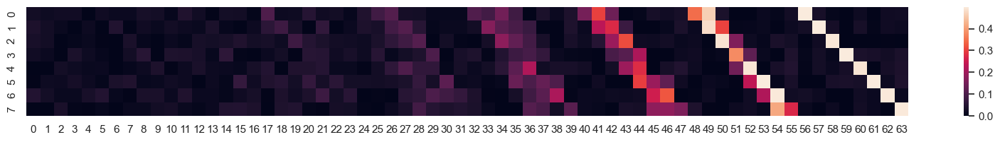

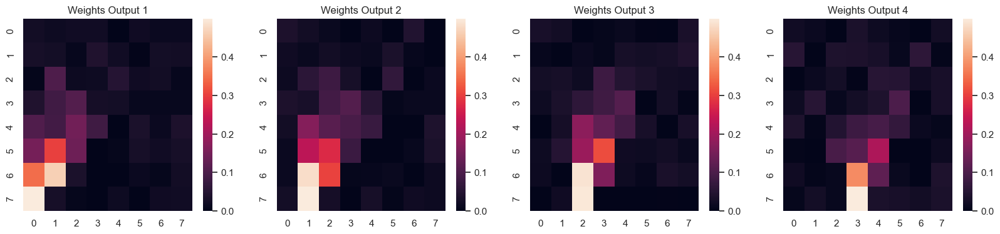

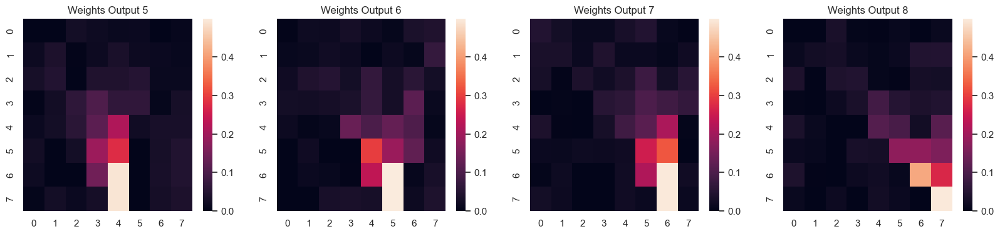

In [24]:
#Connection Matrix (Weights)

weights_copy = S.w
vmax = max(weights_copy)

import seaborn as sns; 
sns.set_theme()

# reshape rows and cols
outputs = [S.w[:, i].reshape(X,X) for i in range(neurons)]
#outputs = [S.w[:, i].reshape(X,2) for i in range(neurons)]
weights_ = [[] for _ in range(neurons)]
#sns.heatmap(S.w[:, 2].reshape(X,X))

for i in range(neurons):
    for el in outputs[i][:]:
        weights_[i].append(el)
    weights_[i] = list(np.array(weights_[i]).flatten())

    
figure(figsize=(20,2))
sns.heatmap(weights_)


# rows
elem_per_row = 4
module = n_labels%elem_per_row
rows = int(n_labels/elem_per_row)+ (0 if module == 0 else 1)
lab_cnt = 0

for j in range(rows):
    figure(figsize=(20,4))
    for k in range(elem_per_row):
        lab_cnt+=1
        subplot('1'+str(elem_per_row)+str(k+1))
        if lab_cnt>n_labels:
            axis('off')
        else:
            title('Weights Output '+str(lab_cnt))
            sns.heatmap(outputs[lab_cnt-1], vmin=0, vmax=vmax)


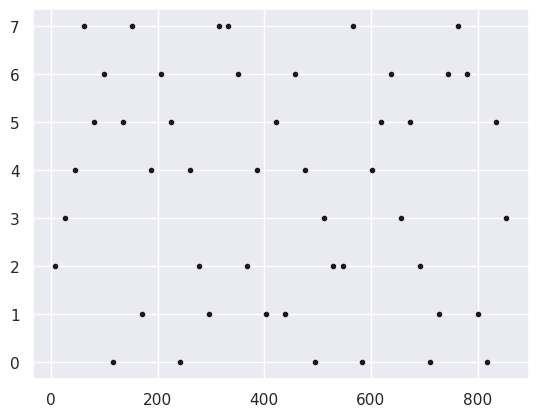

In [25]:
plot(s_mon_out.t/ms, s_mon_out.i, '.k')
s_mon_out.t/ms
plt.style.use("default")

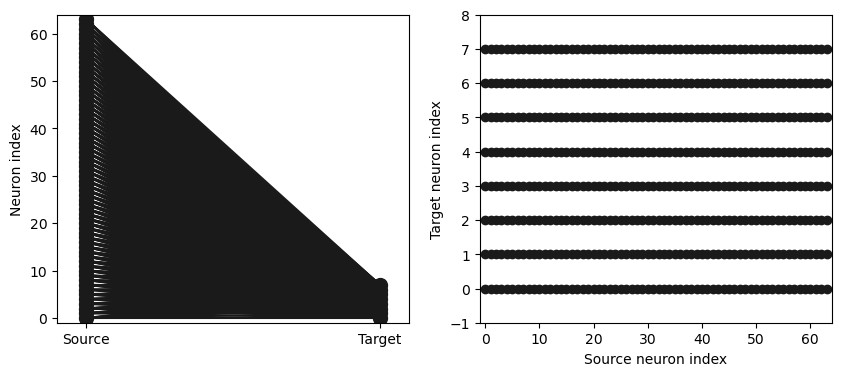

In [26]:
def visualise_connectivity(S):
    Ns = len(S.source)
    Nt = len(S.target)
    figure(figsize=(10, 4))
    subplot(121)
    plot(zeros(Ns), arange(Ns), 'ok', ms=10)
    plot(ones(Nt), arange(Nt), 'ok', ms=10)
    for i, j in zip(S.i, S.j):
        plot([0, 1], [i, j], '-k')
    xticks([0, 1], ['Source', 'Target'])
    ylabel('Neuron index')
    xlim(-0.1, 1.1)
    ylim(-1, max(Ns, Nt))
    subplot(122)
    plot(S.i, S.j, 'ok')
    xlim(-1, Ns)
    ylim(-1, Nt)
    xlabel('Source neuron index')
    ylabel('Target neuron index')

visualise_connectivity(S)

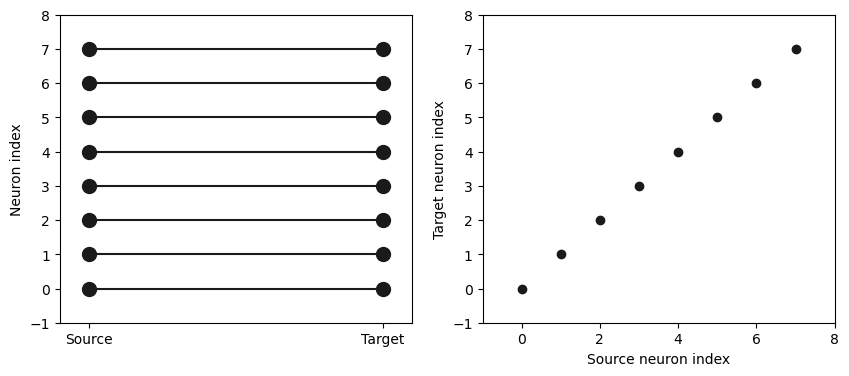

In [27]:
visualise_connectivity(Syn_L)

In [28]:
#visualise_connectivity(Syn_inh)

In [29]:
S.source

SpikeGeneratorGroup(64, indices=<length 384 array>, times=<length 384 array>

In [30]:
Syn_L

Synapses(clock=Clock(dt=100. * usecond, name='defaultclock'), when=start, order=0, name='synapses_1')

In [31]:
# ---------------------------------------------
# ---------------- PARAMETERS -----------------
# ---------------------------------------------

PARAMS = params_list[CONFIGURATION] # best 32
taum = PARAMS.taum
Eexc = PARAMS.Eexc
Erest = PARAMS.Erest
taue = PARAMS.taue
ge = PARAMS.ge
tauL = PARAMS.tauL
gL = PARAMS.gL
vthreshold = -51*mV # -52 -54
vreset = PARAMS.vreset
tauW = PARAMS.tauW
taupre = PARAMS.taupre
taupost = PARAMS.taupost
gmax = PARAMS.gmax
dApre = PARAMS.dApre
dApost = PARAMS.dApost
refractory = PARAMS.refractory

weights = weights_copy

#max_=max(weights_copy)
#min_=min(weights_copy)
#weights = [((x-min_)/(max_-min_)) for x in weights_copy]

#weights = [math.log2(x) for x in weights_copy]

#weights = weights_copy/(0.5*log(len(weights_copy)))
#weights = weights_copy/(0.5*math.log2(len(weights_copy)))
#weights = weights*7
#weights = weights * 10
#/log(0.693147180559945)

# LIF
# (unless refractory)
eqs_neurons = '''
dv/dt = ((Erest - v) + (ge * (Eexc-v)) + (gL * (Eexc-v))) / taum : volt (unless refractory)
dge/dt = -ge / taue : 1
dgL/dt = -gL / tauL : 1
'''

# STDP
eqs_out = '''
dw/dt = -w/tauW : 1
'''
#dw/dt = -w/tauW : 1

eqs_out_pre = '''
ge += w
'''


In [32]:
testset = [x - (label_times[-1]) for x in test_times]
testset_target = [x - (label_times[-1]) for x in label_test_times]
testset = test_times
testset_target = label_test_times

In [33]:
'''
# load pretrained weights list
import json
with open('data/8x8_100/100_weights.json') as f:
    lw = json.load(f)
    
for w in range(len(lw)):
    weights[w] = lw[w]
'''

"\n# load pretrained weights list\nimport json\nwith open('data/8x8_100/100_weights.json') as f:\n    lw = json.load(f)\n    \nfor w in range(len(lw)):\n    weights[w] = lw[w]\n"

In [34]:
weights

<synapses.w: array([2.46838468e-02, 3.81643742e-02, 3.19609552e-02, 2.21025674e-02,
       7.53341488e-16, 1.98947779e-03, 4.65185835e-02, 1.22316026e-10,
       1.87980487e-02, 2.39035275e-02, 2.46765625e-02, 1.51607496e-02,
       1.36154200e-10, 1.88264429e-02, 2.56218696e-02, 1.88861935e-18,
       2.30299844e-02, 1.36144086e-02, 1.62004061e-10, 1.78554705e-31,
       2.55019389e-02, 1.70120577e-02, 1.20634756e-02, 3.48274432e-02,
       2.15112654e-02, 4.12318242e-04, 5.91996060e-03, 3.56018859e-02,
       1.92140686e-02, 2.89662748e-02, 1.30715343e-02, 4.77178961e-03,
       1.53756175e-10, 1.56227441e-02, 1.29380960e-02, 1.86845439e-02,
       1.27384229e-02, 1.74720948e-02, 3.20627248e-02, 2.02496918e-03,
       2.03322775e-02, 7.80955858e-16, 2.42310516e-03, 9.54294533e-03,
       1.45647599e-02, 6.10265187e-03, 4.63771896e-02, 1.07797152e-02,
       1.39188929e-02, 4.45790828e-02, 0.00000000e+00, 1.95212521e-18,
       4.23079810e-05, 3.69085246e-02, 1.12783911e-02, 2.0736543

In [35]:
# ---------------------------------------------
# ----------------- TESTING -------------------
# ---------------------------------------------

start_scope()

G = SpikeGeneratorGroup(N, test_indexes, testset)

out = NeuronGroup(neurons, eqs_neurons, threshold='v>vthreshold', reset='v = vreset', refractory=refractory,
                      method='euler')

S = Synapses(G, out, eqs_out,
             on_pre=eqs_out_pre,
             #on_post=eqs_out_post,
             )
S.connect()
S.w = weights

# INHIBITORY
#Syn_inh = Synapses(Label, out, on_pre='''gL *= 0.1''')
#Syn_inh = Synapses(out, out, on_pre='''ge *= 0.2''') #0.2

#Syn_inh = Synapses(out, out, on_pre='''ge *= -0.1''') #0.2
#Syn_inh = Synapses(out, out, on_pre='''gL = -ge''') #0.2

#Syn_inh = Synapses(out, out, on_post='''gL += 1''') #0.2
#for ilab in range(n_labels):
#    for nj in range(n_labels):
#        if ilab == nj:
#            continue
#        Syn_inh.connect(i=ilab, j=nj)

out.v = vreset*ones(neurons)

neur = [ii for ii in range(neurons)]

all_ = [ii for ii in range(N*neurons)]
first_and_last = [0, 1, 2, 3, 4, 5, 6, 7, 56, 57, 58, 59, 60, 61, 62, 63]
last = [ii for ii in range((N*neurons)-N,(N*neurons))]


#mon = StateMonitor(S, 'w', record=last)
mon_ge = StateMonitor(out, 'ge', record=neur)
mon_gL = StateMonitor(out, 'gL', record=neur)
mon_v = StateMonitor(out, 'v', record=neur)

spike_mon = SpikeMonitor(G)
s_mon_out = SpikeMonitor(out)

#run(testset[-1]+2*ms)
run(t_testing)



WARNING    "gL" is an internal variable of group "neurongroup_1", but also exists in the run namespace with the value 0. The internal variable will be used. [brian2.groups.group.Group.resolve.resolution_conflict]
WARNING    "ge" is an internal variable of group "neurongroup_1", but also exists in the run namespace with the value 0.1. The internal variable will be used. [brian2.groups.group.Group.resolve.resolution_conflict]
INFO       No numerical integration method specified for group 'synapses_2', using method 'exact' (took 0.01s). [brian2.stateupdaters.base.method_choice]
WARNING    "ge" is an internal variable of group "synapses_2", but also exists in the run namespace with the value 0.1. The internal variable will be used. [brian2.groups.group.Group.resolve.resolution_conflict]


WARNING    /var/folders/6m/jw_42_bs0p75rv0sycqq52pr0000gn/T/ipykernel_89885/3586581975.py:31: MatplotlibDeprecationWarning: Passing non-integers as three-element position specification is deprecated since 3.3 and will be removed two minor releases later.
  subplot('1'+str(elem_per_row)+str(k+1))
 [py.warnings]


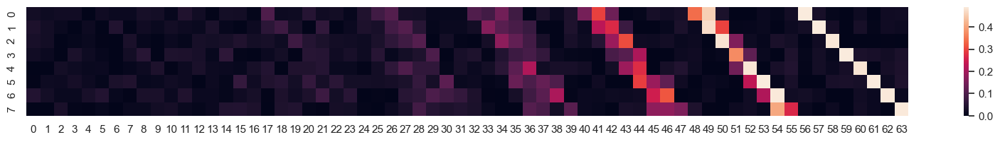

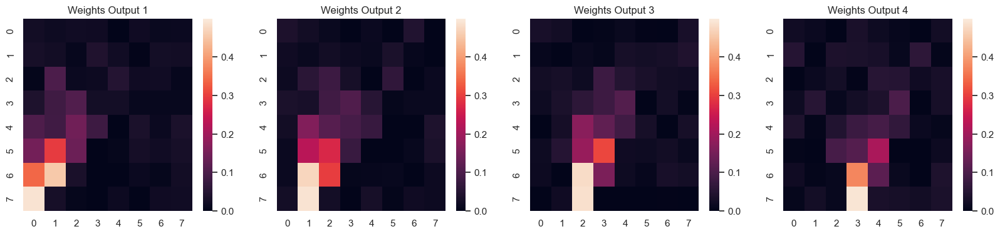

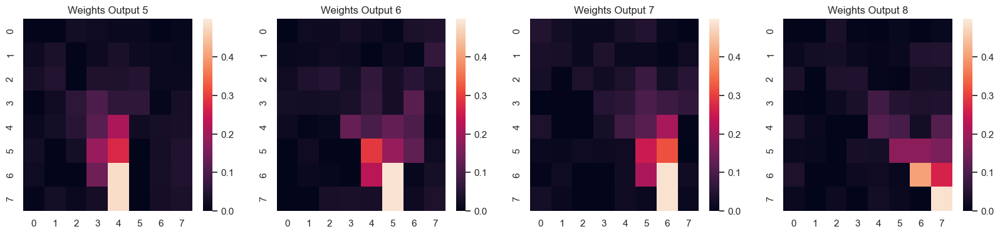

In [36]:
#Connection Matrix (Weights)

import seaborn as sns; 
sns.set_theme()

# reshape rows and cols
outputs = [S.w[:, i].reshape(X,X) for i in range(neurons)]
weights_ = [[] for _ in range(neurons)]
#sns.heatmap(S.w[:, 2].reshape(X,X))

for i in range(neurons):
    for el in outputs[i][:]:
        weights_[i].append(el)
    weights_[i] = list(np.array(weights_[i]).flatten())

    
figure(figsize=(20,2))
sns.heatmap(weights_)


# rows
elem_per_row = 4
module = n_labels%elem_per_row
rows = int(n_labels/elem_per_row)+ (0 if module == 0 else 1)
lab_cnt = 0

for j in range(rows):
    figure(figsize=(20,4))
    for k in range(elem_per_row):
        lab_cnt+=1
        subplot('1'+str(elem_per_row)+str(k+1))
        if lab_cnt>n_labels:
            axis('off')
        else:
            title('Weights Output '+str(lab_cnt))
            sns.heatmap(outputs[lab_cnt-1], vmin=0, vmax=vmax)
            #print labels
            #plt.plot([0,15],[16,16],'-',color='black')


Text(0, 0.5, 'Neuron index')

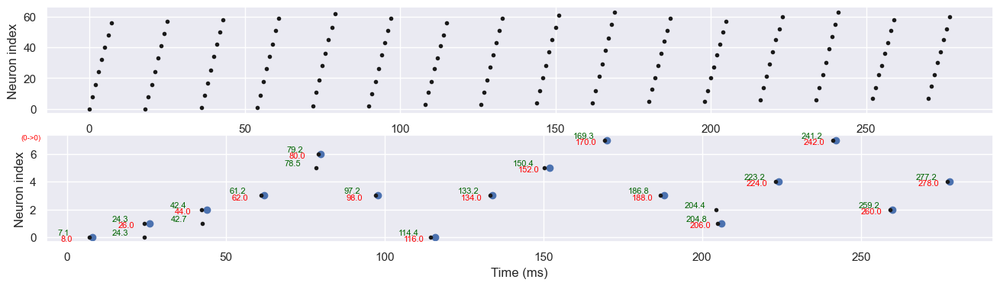

In [37]:
figure(figsize=(16,4))
subplot(211)
plot(spike_mon.t/ms, spike_mon.i, '.k')
xlabel('Time (ms)')
ylabel('Neuron index')

for idx in range(len(label_test_indexes)):
    l_pos = '('+str(test_data[idx][1])+'->'+str(test_data[idx][2])+')'
    plt.text((testset_target[idx]-30*ms)/ms,-20, str(l_pos), color='red', fontsize=7)


subplot(212)
#plot(label_times/ms, label_indexes, 'o')
plot(testset_target/ms, label_test_indexes, 'o')

plot(s_mon_out.t/ms, s_mon_out.i, '.k')

timings = s_mon_out.t/ms
indexes = s_mon_out.i
for idx in range(len(timings)):
    plt.text(timings[idx]-10, indexes[idx]+0.15, str(round(timings[idx],2)), color='darkgreen', fontsize=8)
    
    
timings = testset_target/ms
for idx in range(len(label_test_indexes)):
    plt.text(timings[idx]-10,label_test_indexes[idx]-0.30, str(round(timings[idx],2)), color='red', fontsize=8)

#plot(lab/ms, ind_Label+0.3, 'o')
xlabel('Time (ms)')
ylabel('Neuron index')
#xlim(210,250)


[[(0, 0)], [(0, 1), (1, 1)], [(2, 2), (1, 2)], [(3, 3)], [(5, 6), (6, 6)], [(3, 3)], [(0, 0)], [(3, 3)], [(5, 5)], [(7, 7)], [(3, 3)], [(2, 1), (1, 1)], [(4, 4)], [(7, 7)], [(2, 2)], [(4, 4)]]
0.8125 (13/16)


Text(843.6136363636361, 0.5, 'Labels')

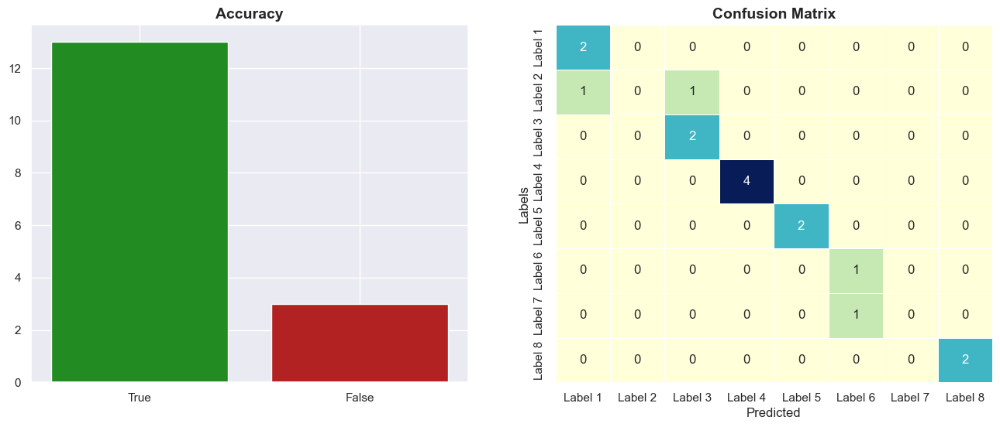

In [38]:
# Accuracy

window = 10*ms
res = [[] for _ in range(len(testset_target))]  

outcome_idx = 0        
label_idx = 0
for label_out_spike in testset_target:
    for i in range(outcome_idx, len(s_mon_out.t)):
        
        delta = abs(s_mon_out.t[i]-label_out_spike)
        if delta <= window:
            res[label_idx].append((s_mon_out.i[i], label_test_indexes[label_idx]))
        else:
            outcome_idx = i
            break
        
    label_idx+=1

first_wins = True 
acc_array = [False for _ in range(len(res))]

for el_idx in range(len(res)):
    
    if len(res[el_idx])==0:
        acc_array[el_idx]=False
    else:
        for a, b in res[el_idx]:
            if a==b:
                acc_array[el_idx]=True
                if first_wins: # check also time, if it is the same is not good
                    break
            else:
                acc_array[el_idx]=False
                break


res_true = sum(acc_array)
res_false = len(res)-res_true
acc = res_true/len(res)
acc_false = 1-acc
print(res)
print(acc, "("+str(sum(res_true))+"/"+str(len(res))+")")

#Confusion Matrix
cm = [[0 for _ in range(n_labels)] for _ in range(n_labels)]
for h in res:
    if len(h) > 0:
        cm[h[0][1]][h[0][0]]+=1


figure(figsize=(16,6))
subplot(121)
title('Accuracy', fontsize=14, fontweight='bold')
bar(["True","False"], [res_true, res_false], color=['forestgreen', 'firebrick'])
#plt.text(x = [res_true-0.5, res_true-0.5] , y = [res_false-0.5, res_false-0.5], s = [acc, acc_false], size = 6)
#text(x=res_true-0.5, y=res_false-0.5, s=acc)
#figure()
subplot(122)
title('Confusion Matrix', fontsize=14, fontweight='bold')

lbls_name = ['Label '+str(k+1) for k in range(n_labels)]
sns.heatmap(cm, xticklabels=lbls_name, yticklabels=lbls_name, annot=True, linewidths=.5, cmap="YlGnBu", cbar=False)
xlabel('Predicted')
ylabel('Labels')

In [39]:
test_dc = {'start':0, 'end':0, 'start_time':0, 'end_time':0}

In [40]:
# Accuracy matrix for each start,end,label point - and distribution
# Save weights, create different folders with configuration and files
# Use the same files for train and test set to well compare experiments
# Save starting random weight
# Perform progressive training with multiple presenttion of train data, based on weight dist and accuracy
# Split one test for each ending label to see where is the difference
# Use logarithmic scale for weights

In [41]:
'''
weights = weights_copy
#save pkl
weights_f = open('weights/100_weights.pkl', 'wb')
pickle.dump(list(weights), weights_f)

# save json
import json
with open('weights/100_weights.json', 'w') as f:
    json.dump(list(weights), f, ensure_ascii=False)
'''

"\nweights = weights_copy\n#save pkl\nweights_f = open('weights/100_weights.pkl', 'wb')\npickle.dump(list(weights), weights_f)\n\n# save json\nimport json\nwith open('weights/100_weights.json', 'w') as f:\n    json.dump(list(weights), f, ensure_ascii=False)\n"